## visualization the yolo output

Current working directory (BASE_DIR): c:\project\pattern recognition and neural network
Constructed ORIGINAL_DATASET_ROOT: c:\project\pattern recognition and neural network\v2_cam1_cam2_split_by_driver
Constructed FINAL_PSEUDO_LABELS_ROOT: c:\project\pattern recognition and neural network\yolo_pseudo_labels_packed

--- Visualizing 10 randomly selected pseudo-labeled images ---
Visualizing: 686.jpg (Original Class: c0) with label: 686.txt


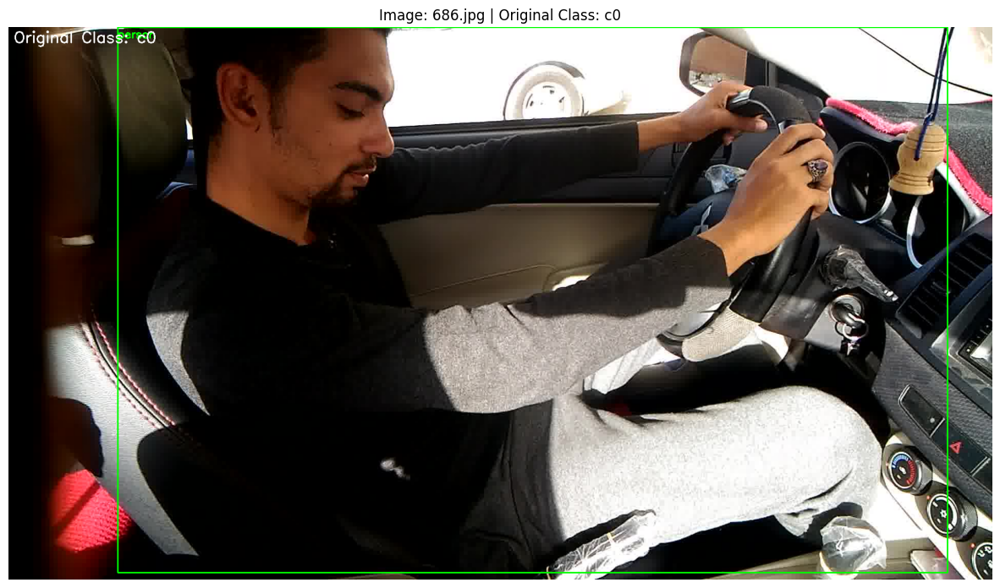

Visualizing: 1243.jpg (Original Class: c9) with label: 1243.txt


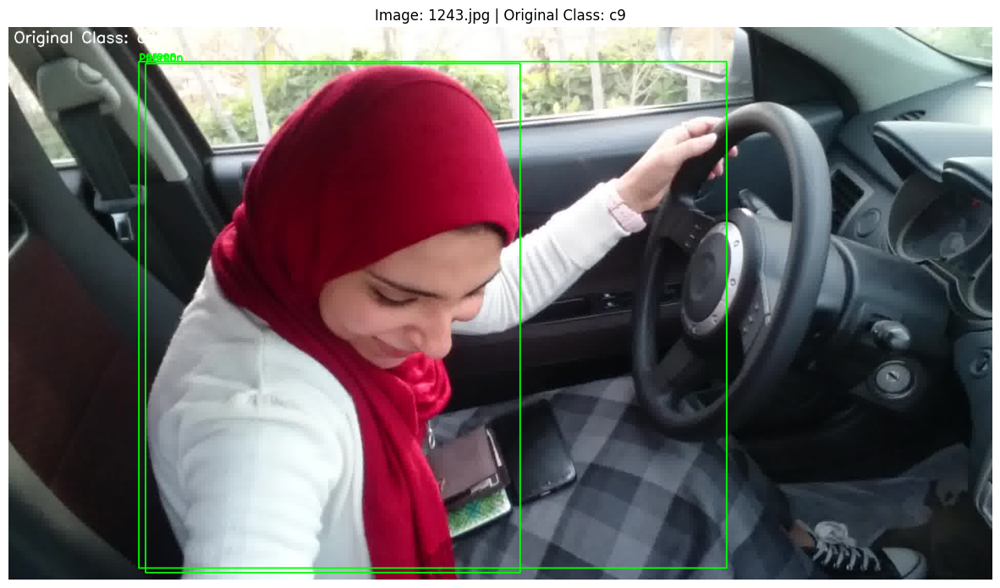

Visualizing: 71975.jpg (Original Class: c2) with label: 71975.txt


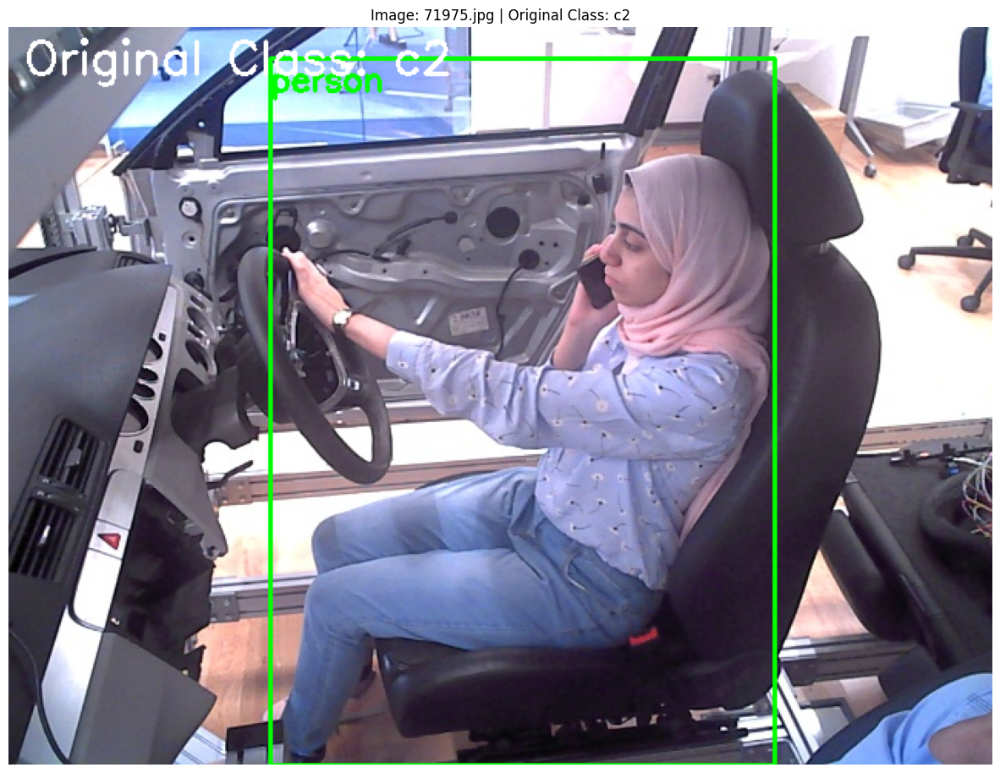

Visualizing: 126495.jpg (Original Class: c7) with label: 126495.txt


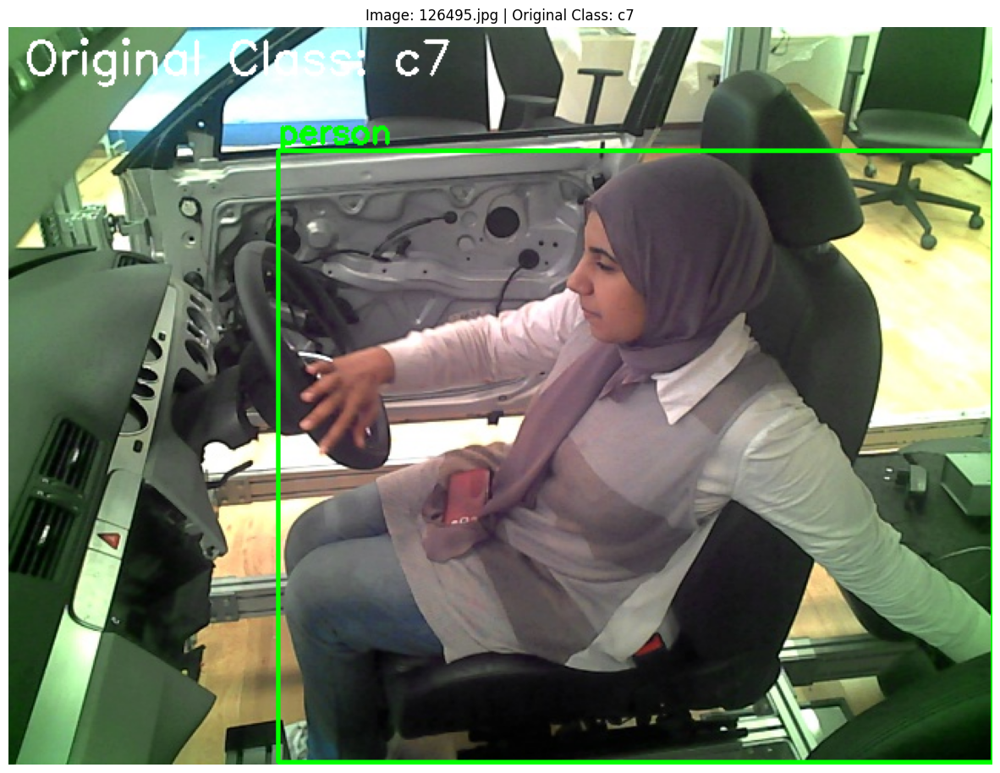

Visualizing: 103915.jpg (Original Class: c4) with label: 103915.txt


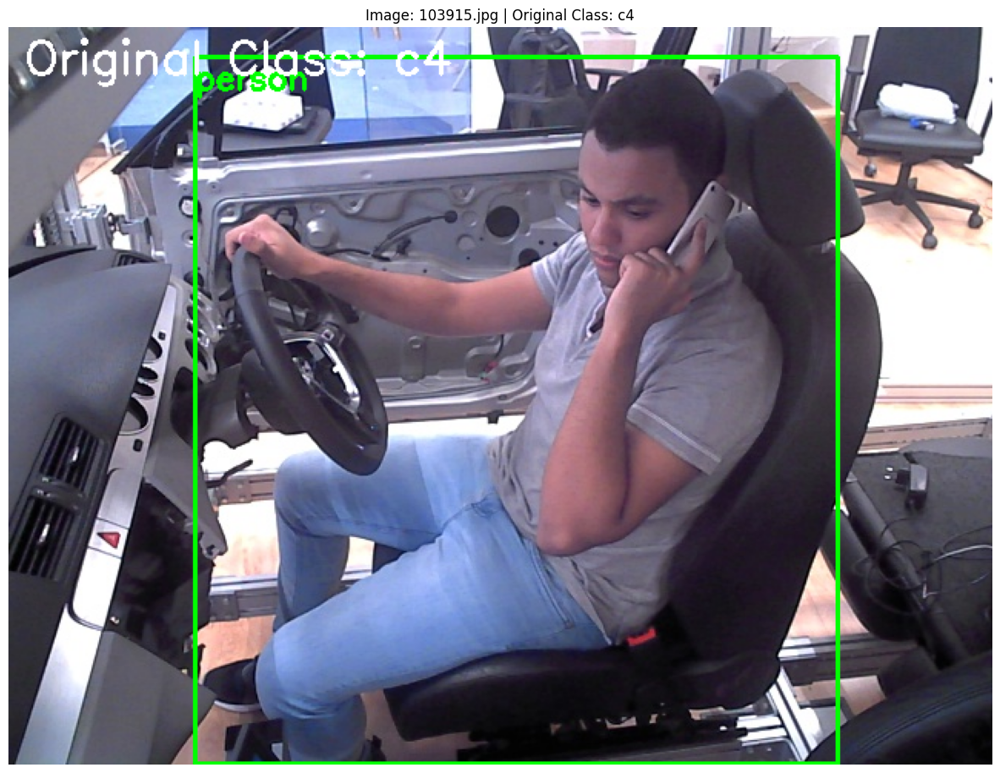

Visualizing: 2366.jpg (Original Class: c0) with label: 2366.txt


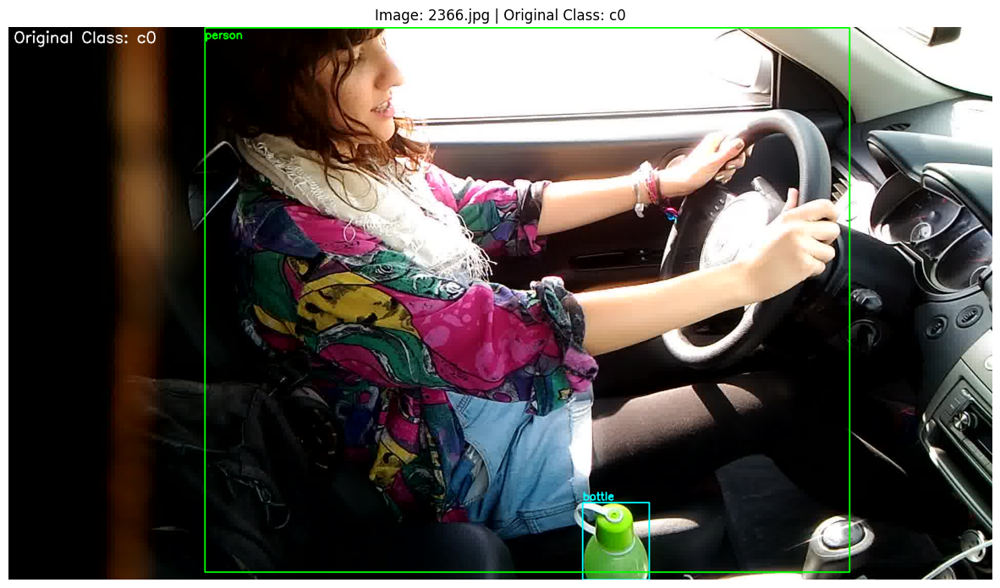

Visualizing: 460.jpg (Original Class: c2) with label: 460.txt


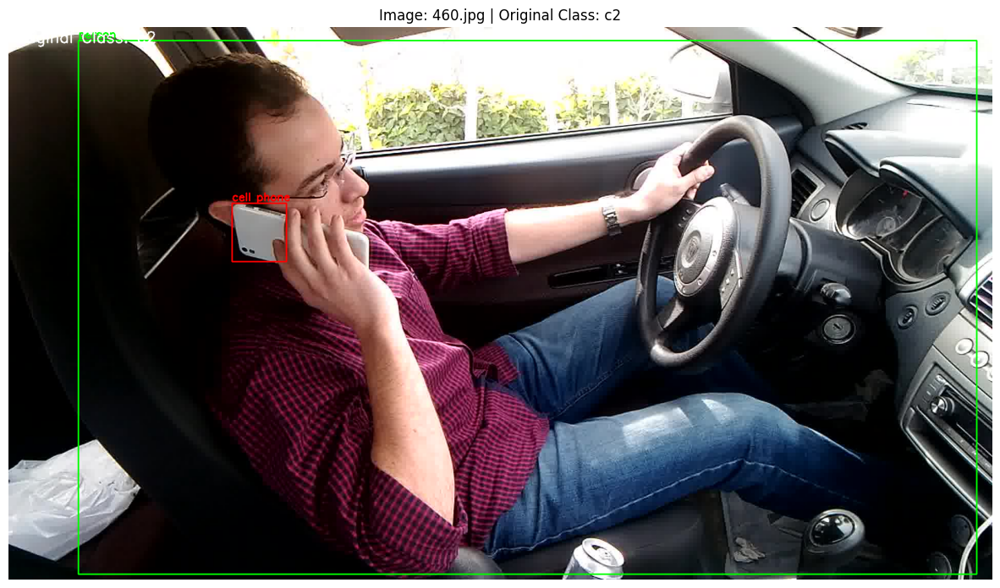

Visualizing: 3648.jpg (Original Class: c0) with label: 3648.txt


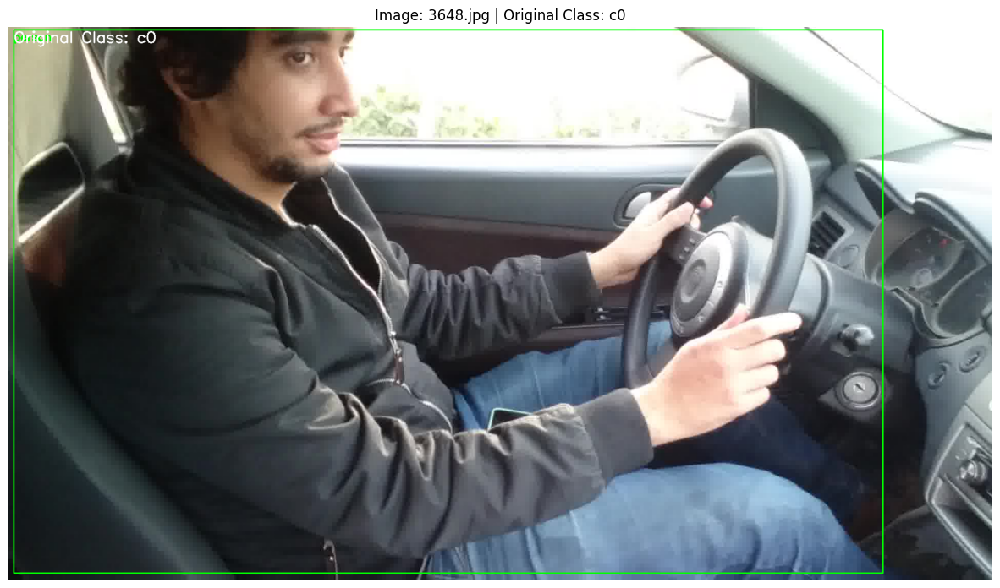

Visualizing: 463.jpg (Original Class: c7) with label: 463.txt


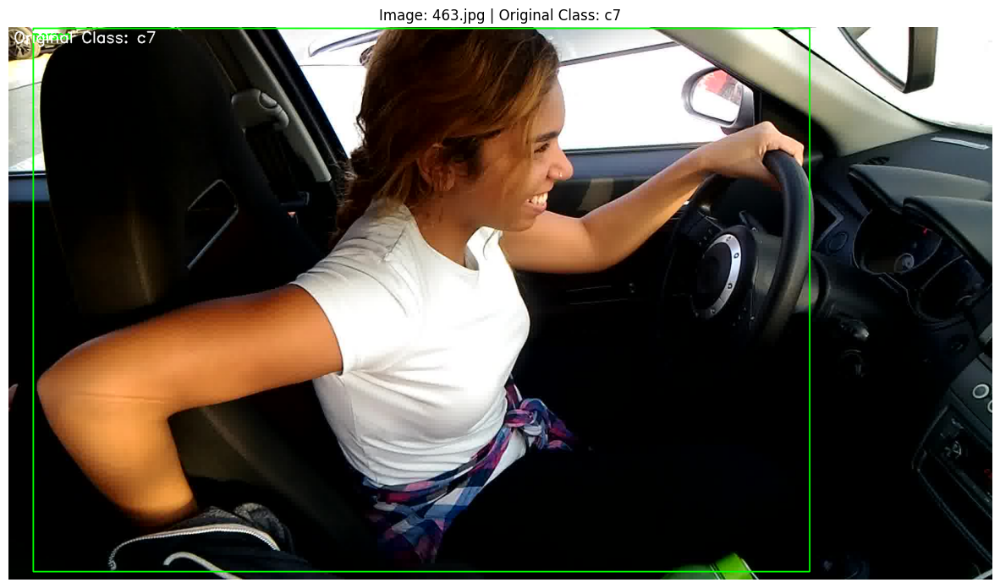

Visualizing: 83016.jpg (Original Class: c3) with label: 83016.txt


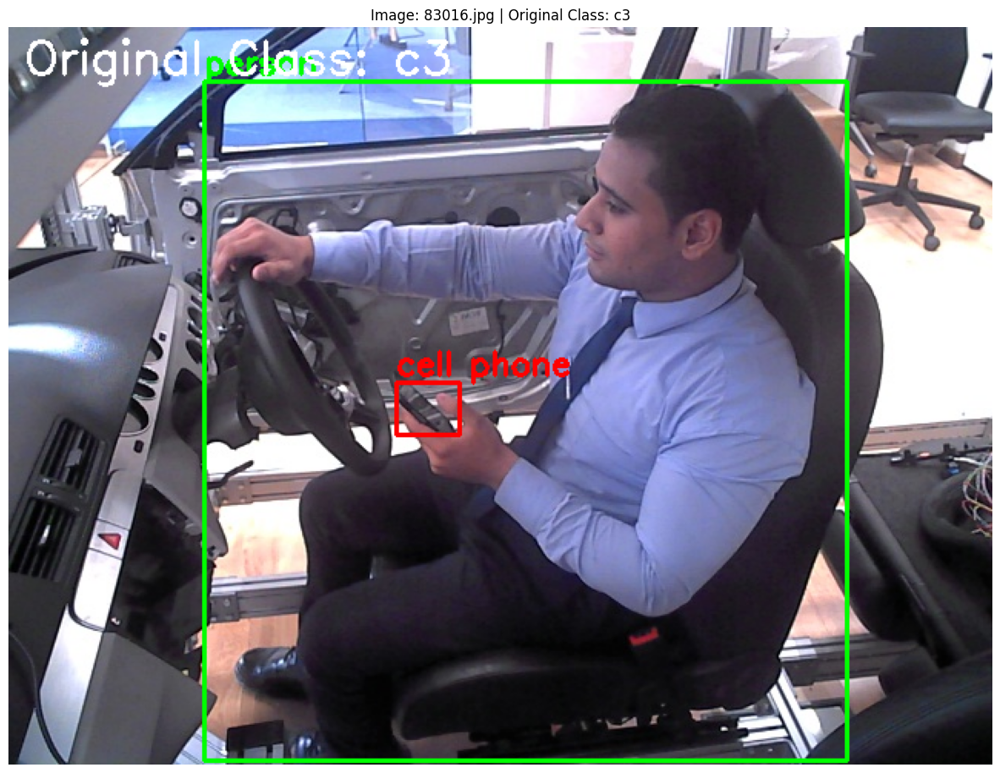

In [ ]:
import cv2
import os
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
import random
import glob
import pandas as pd # Import pandas, as it's now a dependency for data loading

# Get the directory where the current Notebook file is located
BASE_DIR = os.getcwd() 

# Root directory for dataset
ORIGINAL_DATASET_ROOT = os.path.join(BASE_DIR, 'v2_cam1_cam2_split_by_driver')

# Root directory for pseudo-labels
FINAL_PSEUDO_LABELS_ROOT = os.path.join(BASE_DIR, 'yolo_pseudo_labels_packed')

# Confirm BASE_DIR is correct
print(f"Current working directory (BASE_DIR): {BASE_DIR}")
print(f"Constructed ORIGINAL_DATASET_ROOT: {ORIGINAL_DATASET_ROOT}")
print(f"Constructed FINAL_PSEUDO_LABELS_ROOT: {FINAL_PSEUDO_LABELS_ROOT}")


# COCO Class ID to Name mapping (for YOLOv8 detected COCO classes)
COCO_ID_TO_NAME_FOR_VIS = {
    0: 'person',        # COCO Official ID 0 is person
    39: 'bottle',       # COCO Official ID 39 is bottle
    41: 'cup',          # COCO Official ID 41 is cup
    67: 'cell phone',    # COCO Official ID 67 is cell phone
}

# --- Color Definitions (for drawing bounding boxes and text) ---
COLORS = {
    'person': (0, 255, 0),       # Green (BGR format for OpenCV)
    'cell phone': (0, 0, 255),   # Red
    'bottle': (255, 255, 0),     # Cyan
    'cup': (0, 165, 255),        # Orange (BGR format for OpenCV)
    'default': (255, 255, 255)   # White (if an unmapped ID is encountered)
}

# Helper function: Convert normalized coordinates to pixel coordinates
def xywhn2xyxy(x_center, y_center, width, height, img_w, img_h):
    xmin = int((x_center - width / 2) * img_w)
    ymin = int((y_center - height / 2) * img_h)
    xmax = int((x_center + width / 2) * img_w)
    ymax = int((y_center + height / 2) * img_h)
    return xmin, ymin, xmax, ymax

# --- Visualization Function ---
def visualize_yolo_labels_on_image(image_path, label_path, original_class_name="Unknown"):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error: Could not read image at {image_path}")
        return None
    
    img_h, img_w, _ = img.shape

    if not os.path.exists(label_path):
        return img # If no label file, return original image

    with open(label_path, 'r') as f:
        labels = f.readlines()

    if not labels:
        return img # If label file is empty, return original image

    for label in labels:
        parts = label.strip().split(' ')
        if len(parts) != 5:
            print(f"Warning: Malformed label line '{label.strip()}' in {label_path}")
            continue

        class_id = int(parts[0])
        x_center, y_center, width, height = map(float, parts[1:])

        xmin, ymin, xmax, ymax = xywhn2xyxy(x_center, y_center, width, height, img_w, img_h)

        class_name_yolo = COCO_ID_TO_NAME_FOR_VIS.get(class_id, f'Unknown_ID_{class_id}')
        color = COLORS.get(class_name_yolo, COLORS['default'])

        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), color, 2)

        text = f"{class_name_yolo}"
        text_size, _ = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)
        text_x = xmin
        text_y = ymin - 5 if ymin - text_size[1] - 5 > 0 else ymin + text_size[1] + 5
        cv2.putText(img, text, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)
    
    cv2.putText(img, f"Original Class: {original_class_name}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

    return img

# --- Select and Visualize Images ---
NUM_IMAGES_TO_VISUALIZE = 10 

# Get all image paths and their corresponding original classes (c0-c9)
all_image_paths_with_labels = []

# Assuming the original dataset is structured as v2_cam1_cam2_split_by_driver/Camera X/train/cX
# And pseudo-labels are in yolo_pseudo_labels_packed/Camera X/train/cX
for camera_folder in ['Camera 1', 'Camera 2']:
    for dataset_type in ['train', 'test']:
        for i in range(10): # Iterate through c0-c9 folders
            class_folder = f"c{i}"
            
            image_dir_path = os.path.join(ORIGINAL_DATASET_ROOT, camera_folder, dataset_type, class_folder)
            
            image_files = glob.glob(os.path.join(image_dir_path, '*.jpg'))
            for img_path in image_files:
                all_image_paths_with_labels.append((img_path, class_folder))

if not all_image_paths_with_labels:
    print("No images found in the dataset for visualization. Check DATASET_ROOT and its subdirectories.")
else:
    random.seed(1) # Set random seed for reproducibility
    selected_samples = random.sample(all_image_paths_with_labels, min(NUM_IMAGES_TO_VISUALIZE, len(all_image_paths_with_labels)))

    print(f"\n--- Visualizing {len(selected_samples)} randomly selected pseudo-labeled images ---")
    
    for img_path, original_class_folder in selected_samples:
        # Derive the path to the pseudo-label file
        # Extract the relative path of the image from ORIGINAL_DATASET_ROOT (e.g., 'Camera 1/train/c0/1000.jpg')
        relative_path_to_img = os.path.relpath(img_path, ORIGINAL_DATASET_ROOT)
        # Append it to FINAL_PSEUDO_LABELS_ROOT, replacing '.jpg' with '.txt'
        label_path = os.path.join(FINAL_PSEUDO_LABELS_ROOT, relative_path_to_img.replace('.jpg', '.txt'))

        print(f"Visualizing: {os.path.basename(img_path)} (Original Class: {original_class_folder}) with label: {os.path.basename(label_path)}")
        
        # Check if image and label files exist
        if not os.path.exists(img_path):
            print(f"  - Error: Image file not found at {img_path}. Skipping.")
            continue
        if not os.path.exists(label_path):
            print(f"  - Warning: Label file not found at {label_path}. Visualizing image only.")
            # Option to display image only, or skip
            labeled_img = cv2.imread(img_path)
            cv2.putText(labeled_img, f"Original Class: {original_class_folder}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
        else:
            labeled_img = visualize_yolo_labels_on_image(img_path, label_path, original_class_name=original_class_folder)
        
        if labeled_img is not None:
            plt.figure(figsize=(15, 12))
            plt.imshow(cv2.cvtColor(labeled_img, cv2.COLOR_BGR2RGB))
            plt.title(f"Image: {os.path.basename(img_path)} | Original Class: {original_class_folder}")
            plt.axis('off')
            plt.show()

## visualization the MediaPipe Face Mesh output

Current working directory (BASE_DIR): c:\project\pattern recognition and neural network
Constructed ORIGINAL_DATASET_ROOT: c:\project\pattern recognition and neural network\v2_cam1_cam2_split_by_driver
Constructed FINAL_PSEUDO_LABELS_ROOT: c:\project\pattern recognition and neural network\yolo_pseudo_labels_packed

--- Visualizing 10 randomly selected MediaPipe results ---
Visualizing: 686.jpg (Original Class: c0)


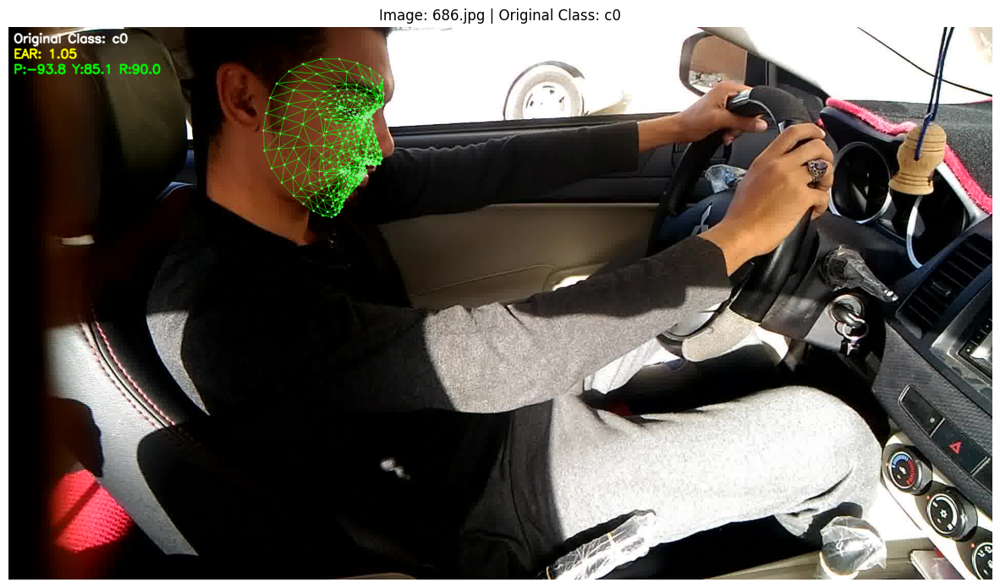

Visualizing: 1243.jpg (Original Class: c9)


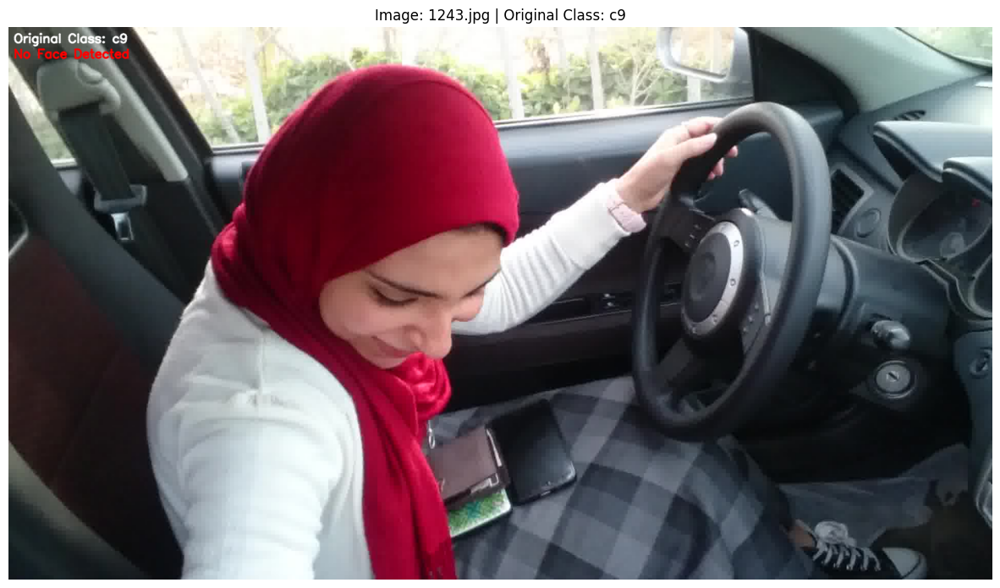

Visualizing: 71975.jpg (Original Class: c2)


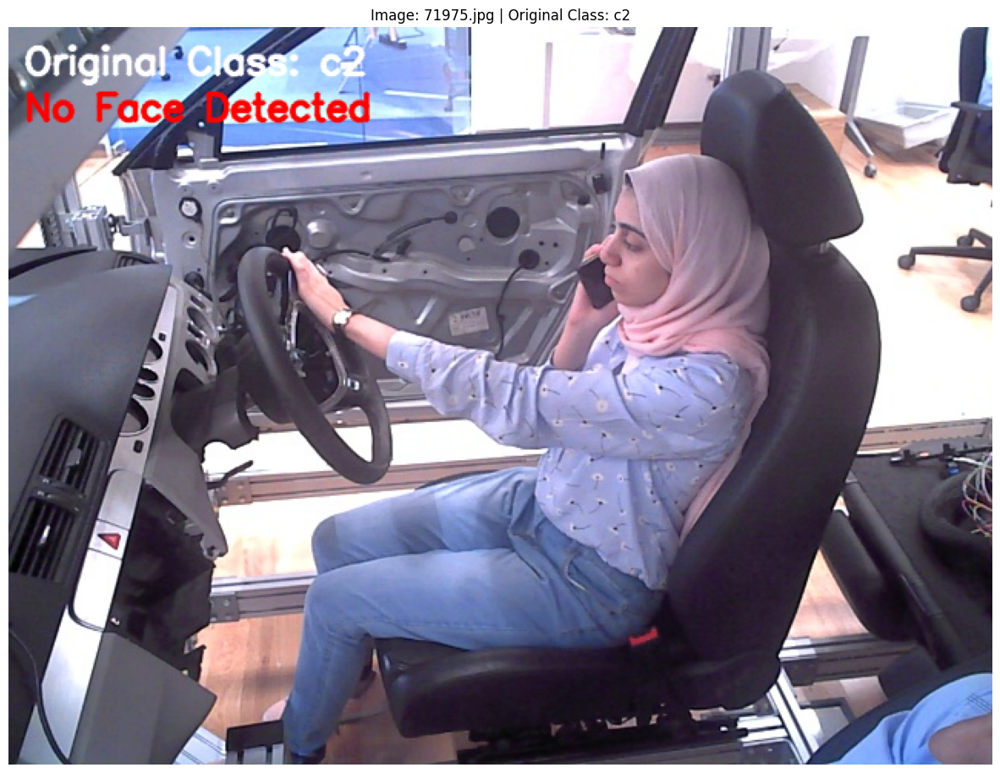

Visualizing: 126495.jpg (Original Class: c7)


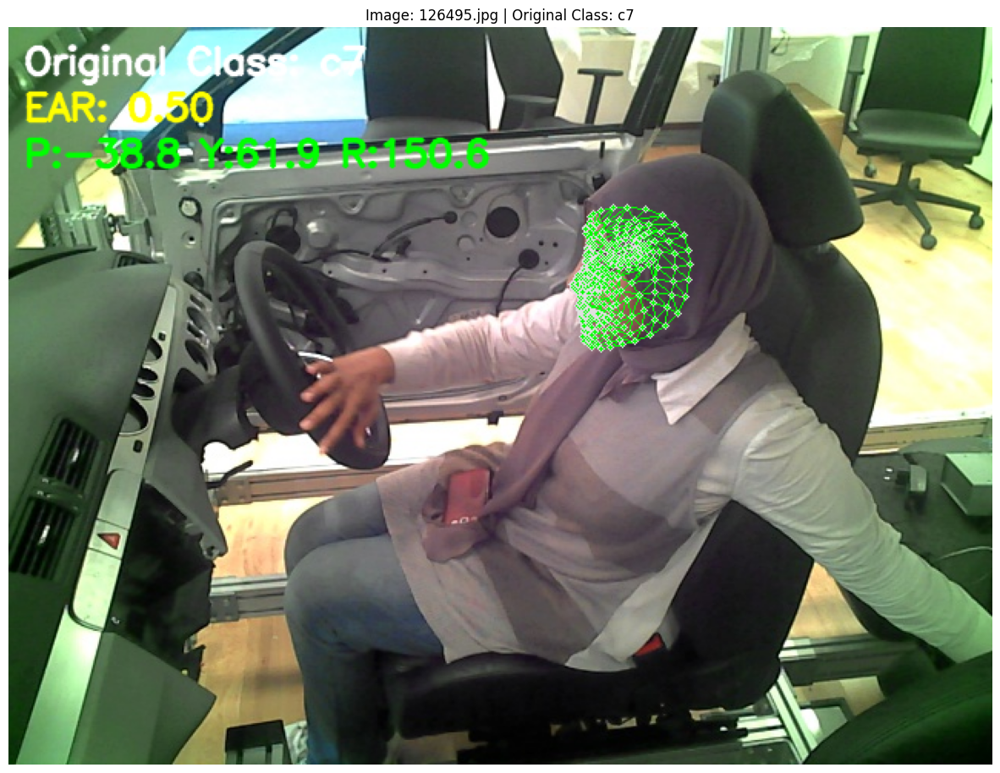

Visualizing: 103915.jpg (Original Class: c4)


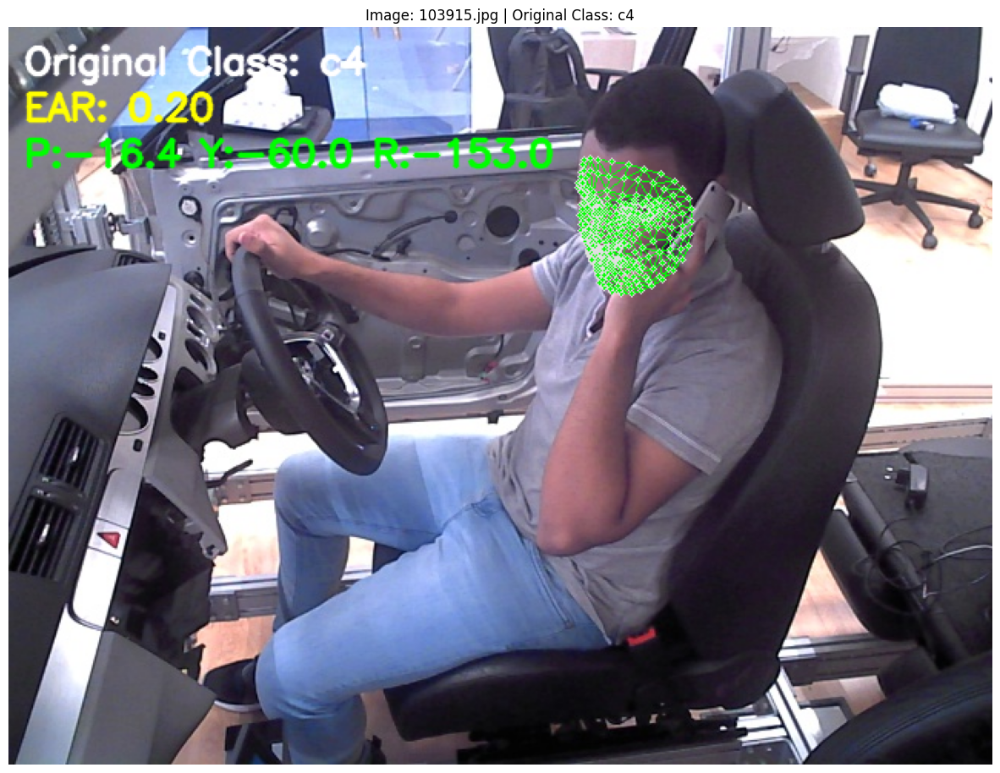

Visualizing: 2366.jpg (Original Class: c0)


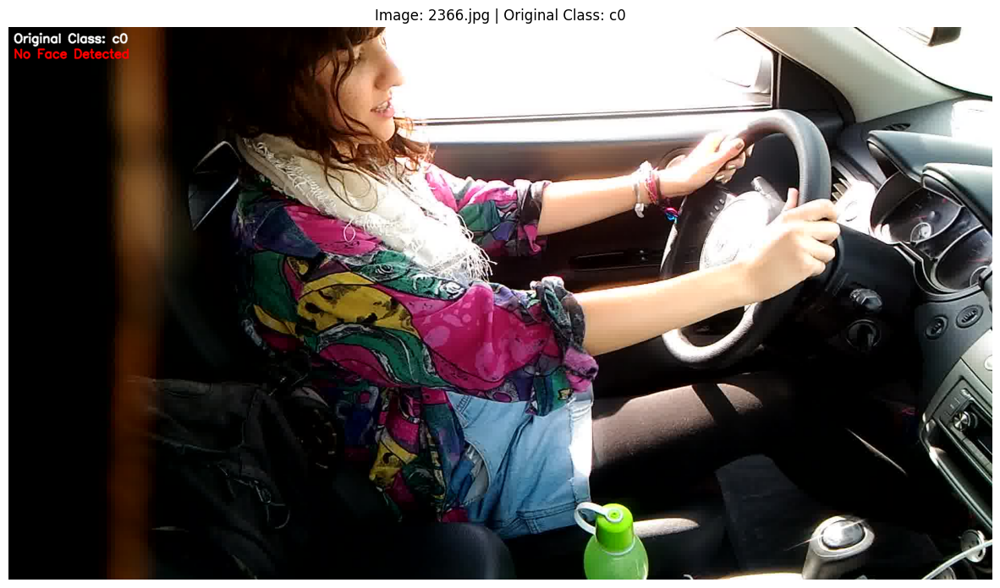

Visualizing: 460.jpg (Original Class: c2)


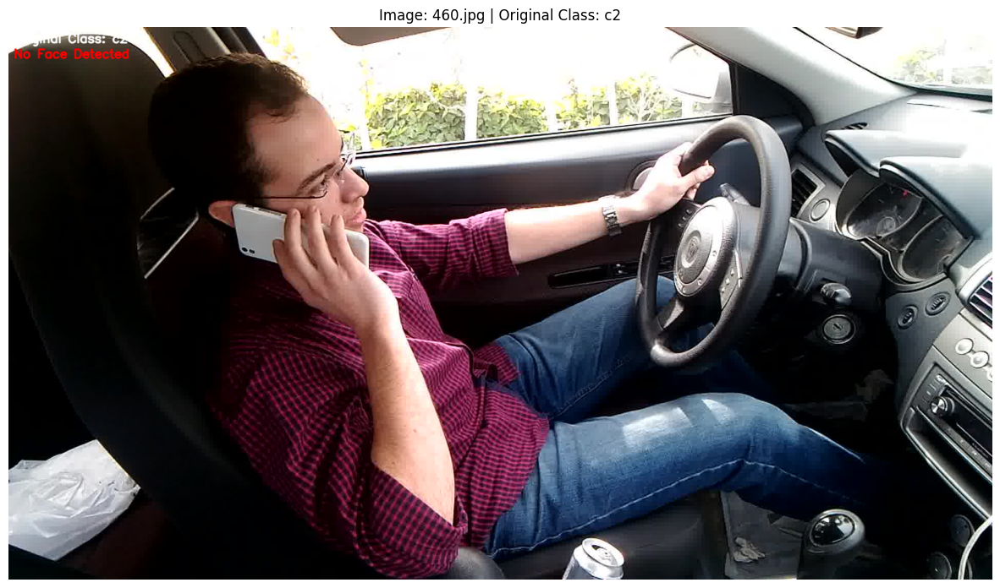

Visualizing: 3648.jpg (Original Class: c0)


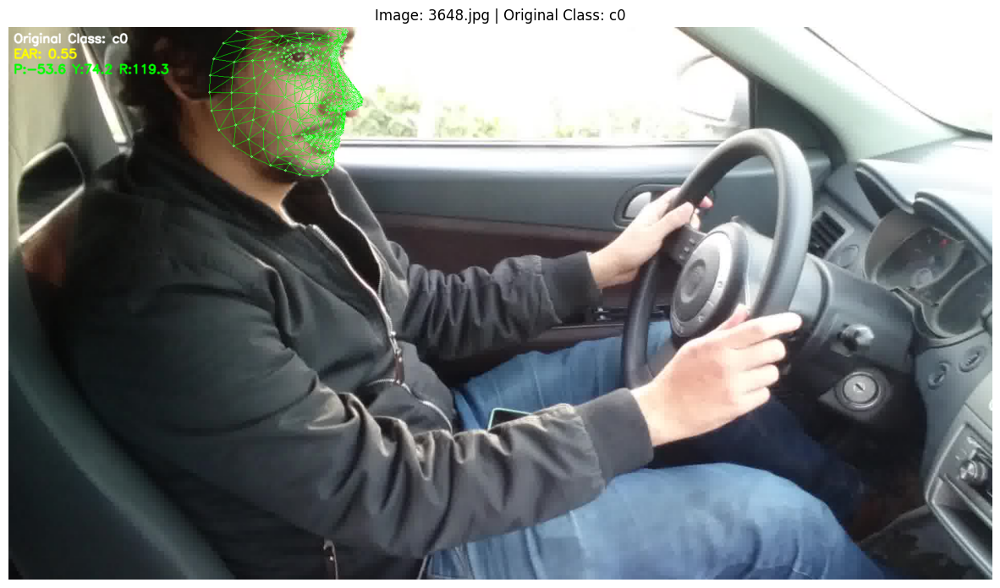

Visualizing: 463.jpg (Original Class: c7)


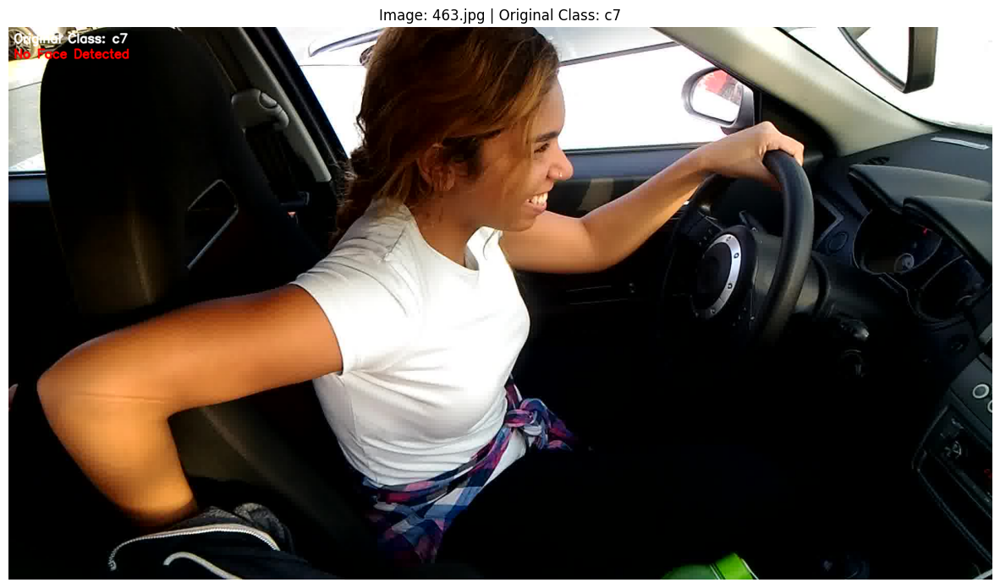

Visualizing: 83016.jpg (Original Class: c3)


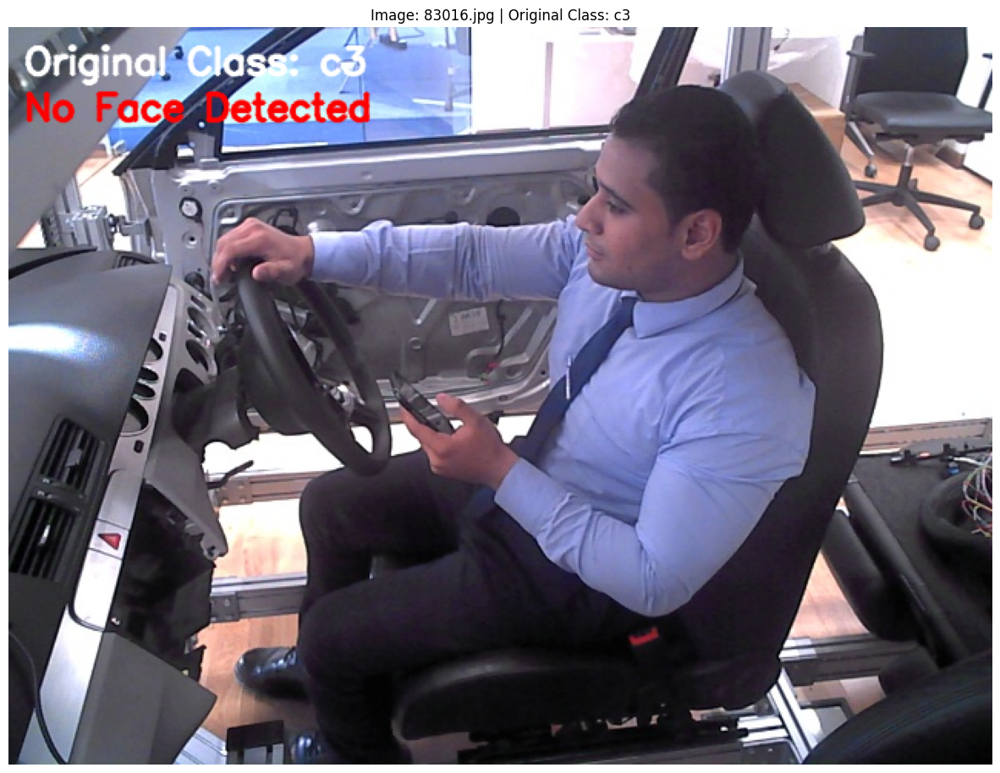

In [3]:
import cv2
import os
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
import random
import glob
import math # for EAR calculations
import mediapipe as mp

# --- Configuration Paths (Adjust this section for your local setup) ---
# Get the directory where the current Notebook file is located
# In Jupyter Notebook, os.getcwd() returns the directory of the .ipynb file itself.
# Assuming this Notebook is in your '5831/' directory
BASE_DIR = os.getcwd() 

# Root directory for your original dataset
# Assuming 'v2_cam1_cam2_split_by_driver' folder is directly under BASE_DIR
ORIGINAL_DATASET_ROOT = os.path.join(BASE_DIR, 'v2_cam1_cam2_split_by_driver')

# Root directory for your pseudo-labels (though not directly read by this script, keep for consistency)
# Assuming 'yolo_pseudo_labels_packed' folder is directly under BASE_DIR
FINAL_PSEUDO_LABELS_ROOT = os.path.join(BASE_DIR, 'yolo_pseudo_labels_packed') # Used for relative path resolution

# Print constructed paths for verification
print(f"Current working directory (BASE_DIR): {BASE_DIR}")
print(f"Constructed ORIGINAL_DATASET_ROOT: {ORIGINAL_DATASET_ROOT}")
print(f"Constructed FINAL_PSEUDO_LABELS_ROOT: {FINAL_PSEUDO_LABELS_ROOT}")

# --- MediaPipe related configurations and helper functions ---
mp_face_mesh = mp.solutions.face_mesh
mp_drawing = mp.solutions.drawing_utils
# Drawing specifications for landmarks and connections
drawing_spec = mp_drawing.DrawingSpec(thickness=1, circle_radius=1, color=(0, 255, 0)) # Green landmarks

# EAR Calculation Helper Function
# MediaPipe Face Mesh precise eye landmark indices (based on common implementations)
LEFT_EYE_INDICES = [362, 385, 387, 263, 373, 380]  # Left eye (right side of image)
RIGHT_EYE_INDICES = [33, 159, 158, 133, 153, 145] # Right eye (left side of image)

def euclidean_distance(point1_norm, point2_norm, img_w, img_h):
    # Convert normalized coordinates to pixel coordinates before calculating distance
    p1_x, p1_y = point1_norm.x * img_w, point1_norm.y * img_h
    p2_x, p2_y = point2_norm.x * img_w, point2_norm.y * img_h
    return math.sqrt((p1_x - p2_x)**2 + (p1_y - p2_y)**2)

def calculate_ear(landmarks, eye_indices, img_w, img_h):
    if not landmarks: return 0.0

    # Extract normalized coordinates of the 6 keypoints for the eye
    p1 = landmarks.landmark[eye_indices[0]]
    p4 = landmarks.landmark[eye_indices[3]]
    p2 = landmarks.landmark[eye_indices[1]]
    p3 = landmarks.landmark[eye_indices[2]]
    p5 = landmarks.landmark[eye_indices[4]]
    p6 = landmarks.landmark[eye_indices[5]]

    # Calculate Euclidean distances
    v1 = euclidean_distance(p2, p6, img_w, img_h) # Vertical distance 1
    v2 = euclidean_distance(p3, p5, img_w, img_h) # Vertical distance 2
    h = euclidean_distance(p1, p4, img_w, img_h) # Horizontal distance

    if h == 0: # Avoid division by zero
        return 0.0

    ear = (v1 + v2) / (2.0 * h)
    return ear

# Helper function: Convert normalized YOLO coordinates to pixel (xmin, ymin, xmax, ymax) coordinates
def xywhn2xyxy(x_center, y_center, width, height, img_w, img_h):
    xmin = int((x_center - width / 2) * img_w)
    ymin = int((y_center - height / 2) * img_h)
    xmax = int((x_center + width / 2) * img_w)
    ymax = int((y_center + height / 2) * img_h)
    return xmin, ymin, xmax, ymax

# Head Pose Calculation Helper Function (using MediaPipe 3D landmarks and solvePnP)
MODEL_3D_POINTS = np.array([
    (0.0, 0.0, 0.0),             # Nose tip (MediaPipe index 1) - used as origin
    (-225.0, 170.0, -135.0),     # Left eye outer corner (MediaPipe index 263)
    (225.0, 170.0, -135.0),      # Right eye outer corner (MediaPipe index 33)
    (-150.0, -150.0, -125.0),    # Left mouth corner (MediaPipe index 61)
    (150.0, -150.0, -125.0),     # Right mouth corner (MediaPipe index 291)
    (0.0, -330.0, -65.0)         # Chin tip (MediaPipe index 152)
], dtype="double")

MEDIAPIPE_POINTS_INDICES = [1, 263, 33, 61, 291, 152]

def calculate_head_pose(landmarks, img_w, img_h):
    if not landmarks: return 0.0, 0.0, 0.0 # pitch, yaw, roll

    image_points = np.array([
        (landmarks.landmark[idx].x * img_w, landmarks.landmark[idx].y * img_h)
        for idx in MEDIAPIPE_POINTS_INDICES
    ], dtype="double")

    focal_length = img_w
    center = (img_w / 2, img_h / 2)
    camera_matrix = np.array([
        [focal_length, 0, center[0]],
        [0, focal_length, center[1]],
        [0, 0, 1]
    ], dtype="double")
    dist_coeffs = np.zeros((4, 1))

    success, rotation_vector, translation_vector = cv2.solvePnP(
        MODEL_3D_POINTS, image_points, camera_matrix, dist_coeffs, flags=cv2.SOLVEPNP_ITERATIVE
    )

    if not success: return 0.0, 0.0, 0.0

    rmat, _ = cv2.Rodrigues(rotation_vector)

    try:
        sy = math.sqrt(rmat[0,0] * rmat[0,0] + rmat[1,0] * rmat[1,0])
        singular = sy < 1e-6

        if not singular:
            x = math.atan2(rmat[2,1], rmat[2,2]) # pitch
            y = math.atan2(-rmat[2,0], sy)       # yaw
            z = math.atan2(rmat[1,0], rmat[0,0]) # roll
        else: # Handle singularity if sy is near zero
            x = math.atan2(-rmat[1,2], rmat[1,1])
            y = math.atan2(-rmat[2,0], sy)
            z = 0

        pitch = math.degrees(x)
        yaw = math.degrees(y)
        roll = math.degrees(z)
        return pitch, yaw, roll
    except Exception as e:
        print(f"  - Error calculating Euler angles: {e}. Returning default pose.")
        return 0.0, 0.0, 0.0

# --- Function to visualize MediaPipe results on an image ---
def visualize_mediapipe_results(image_path, original_class_name="Unknown"):
    img_orig = cv2.imread(image_path)
    if img_orig is None:
        print(f"Error: Could not read image at {image_path}")
        return None
    
    img_rgb = cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB) 
    img_h, img_w, _ = img_orig.shape

    with mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=1, refine_landmarks=True, min_detection_confidence=0.5) as face_mesh:
        results_mp = face_mesh.process(img_rgb)

        img_annotated = img_orig.copy() # Make a copy to draw on

        if results_mp.multi_face_landmarks:
            face_landmarks = results_mp.multi_face_landmarks[0] 

            # --- Draw landmarks and connections ---
            mp_drawing.draw_landmarks(
                image=img_annotated,
                landmark_list=face_landmarks,
                connections=mp_face_mesh.FACEMESH_TESSELATION, # Draw face mesh
                landmark_drawing_spec=drawing_spec,
                connection_drawing_spec=drawing_spec)
            mp_drawing.draw_landmarks(
                image=img_annotated,
                landmark_list=face_landmarks,
                connections=mp_face_mesh.FACEMESH_CONTOURS, # Draw face contours
                landmark_drawing_spec=drawing_spec,
                connection_drawing_spec=drawing_spec)

            # --- Calculate and display EAR ---
            ear_left = calculate_ear(face_landmarks, LEFT_EYE_INDICES, img_w, img_h)
            ear_right = calculate_ear(face_landmarks, RIGHT_EYE_INDICES, img_w, img_h)
            avg_ear = (ear_left + ear_right) / 2
            
            ear_text = f"EAR: {avg_ear:.2f}"
            cv2.putText(img_annotated, ear_text, (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 255), 2, cv2.LINE_AA) # Yellow text

            # --- Calculate and display Head Pose ---
            pitch, yaw, roll = calculate_head_pose(face_landmarks, img_w, img_h)
            
            pose_text = f"P:{pitch:.1f} Y:{yaw:.1f} R:{roll:.1f}" # P=Pitch, Y=Yaw, R=Roll
            cv2.putText(img_annotated, pose_text, (10, 90), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2, cv2.LINE_AA) # Green text

        else:
            # If no face is detected
            cv2.putText(img_annotated, f"No Face Detected", (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2, cv2.LINE_AA) # Red text
        
        # --- Display Original Class (always) ---
        cv2.putText(img_annotated, f"Original Class: {original_class_name}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2, cv2.LINE_AA)

        return img_annotated


# --- Select and Visualize Images (Main Execution Block) ---
NUM_IMAGES_TO_VISUALIZE = 10 # Number of images to visualize

# Get all image paths and their corresponding original classes (c0-c9)
all_image_paths_with_labels = []

# Iterate through Camera 1 and Camera 2
for camera_folder in ['Camera 1', 'Camera 2']:
    # Iterate through 'train' and 'test' subdirectories
    for dataset_type in ['train', 'test']:
        # Iterate through c0-c9 class folders
        for i in range(10): 
            class_folder = f"c{i}"
            
            # Construct the full path to the current image class directory
            image_dir_path = os.path.join(ORIGINAL_DATASET_ROOT, camera_folder, dataset_type, class_folder)
            
            # Find all .jpg image files in this directory
            image_files = glob.glob(os.path.join(image_dir_path, '*.jpg'))
            for img_path in image_files:
                all_image_paths_with_labels.append((img_path, class_folder))

if not all_image_paths_with_labels:
    print("No images found in the dataset for visualization. Check ORIGINAL_DATASET_ROOT and its subdirectories.")
else:
    random.seed(1) # Set random seed for reproducibility
    selected_samples = random.sample(all_image_paths_with_labels, min(NUM_IMAGES_TO_VISUALIZE, len(all_image_paths_with_labels)))

    print(f"\n--- Visualizing {len(selected_samples)} randomly selected MediaPipe results ---")
    
    for img_path, original_class_folder in selected_samples:
        print(f"Visualizing: {os.path.basename(img_path)} (Original Class: {original_class_folder})")
        
        annotated_img = visualize_mediapipe_results(img_path, original_class_name=original_class_folder)
        
        if annotated_img is not None:
            plt.figure(figsize=(15, 12)) # Adjust figure size for display
            # MediaPipe's annotated image from OpenCV is BGR, matplotlib expects RGB
            plt.imshow(cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB))
            plt.title(f"Image: {os.path.basename(img_path)} | Original Class: {original_class_folder}")
            plt.axis('off') # Do not display axes
            plt.show()
            
            # --- Optional: Save annotated images to a local folder for review ---
            # output_vis_dir = os.path.join(BASE_DIR, 'output_mediapipe_vis/')
            # os.makedirs(output_vis_dir, exist_ok=True)
            # output_filename = f"mediapipe_{original_class_folder}_{os.path.basename(img_path)}"
            # cv2.imwrite(os.path.join(output_vis_dir, output_filename), annotated_img)
            # print(f"  - Saved annotated image to {os.path.join(output_vis_dir, output_filename)}")

## visualize the feature table

Loading features from: c:\project\pattern recognition and neural network\extracted_features.csv
Successfully loaded 14478 samples.

--- Feature DataFrame Head ---
   original_class  has_person  person_bbox_xmin  person_bbox_ymin  \
0               0           1                12                 0   
1               0           0                -1                -1   
2               0           1               448                 9   
3               0           1               397                 8   
4               0           1               160                 0   

   person_bbox_xmax  person_bbox_ymax  has_cell_phone  cell_phone_bbox_xmin  \
0              1587              1032               0                    -1   
1                -1                -1               0                    -1   
2              1788              1057               0                    -1   
3              1808              1059               0                    -1   
4              1644        

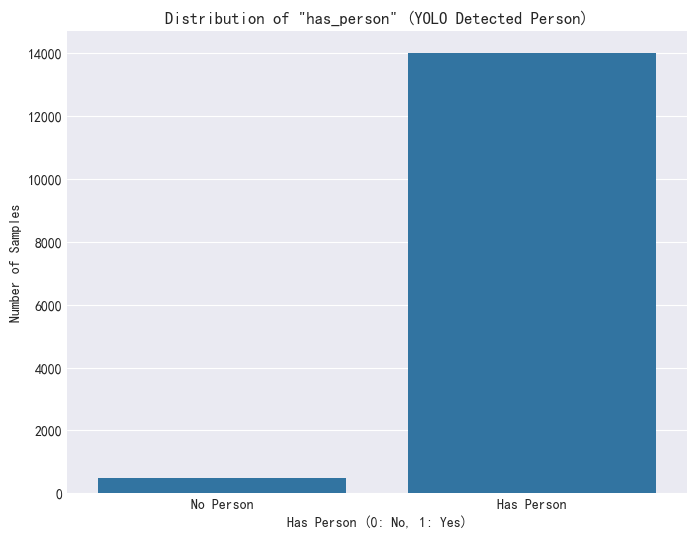

C:\Users\15059\AppData\Local\Temp\ipykernel_9672\205646652.py:57: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='original_class', data=features_df, palette='viridis')


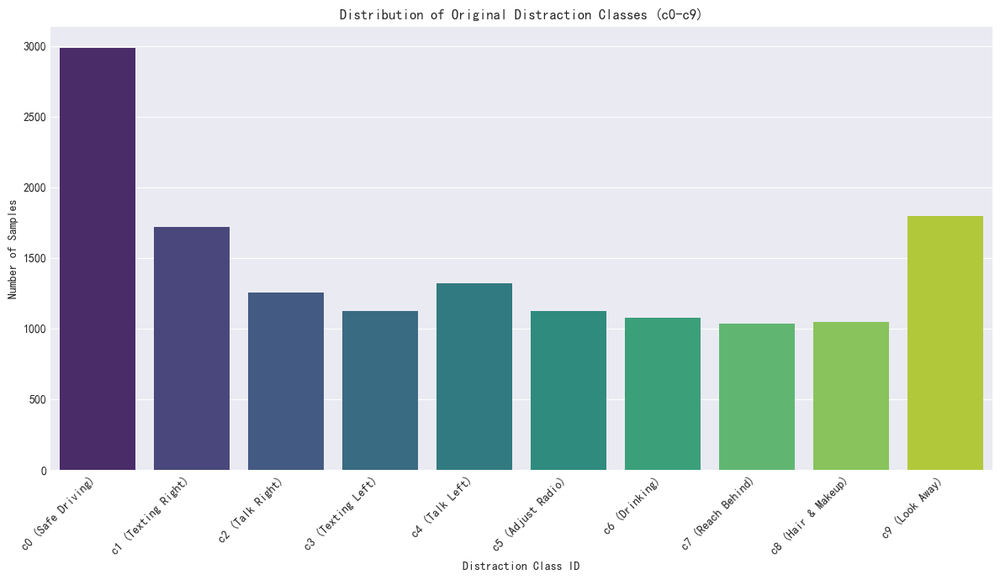


--- Proportion of samples with 'has_person' ---
has_person
1    96.622462
0     3.377538
Name: proportion, dtype: float64


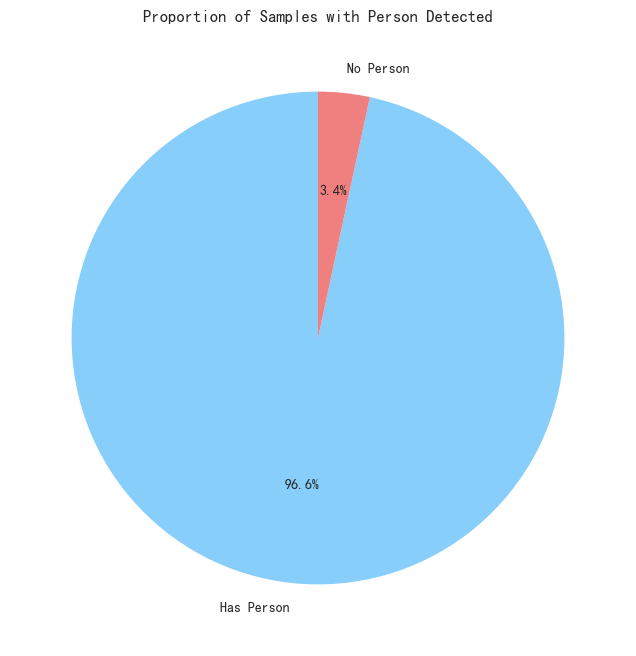


--- Proportion of samples where MediaPipe failed to extract face info (despite has_person=1) ---
mediapipe_failed_face_info
True     60.450338
False    39.549662
Name: proportion, dtype: float64


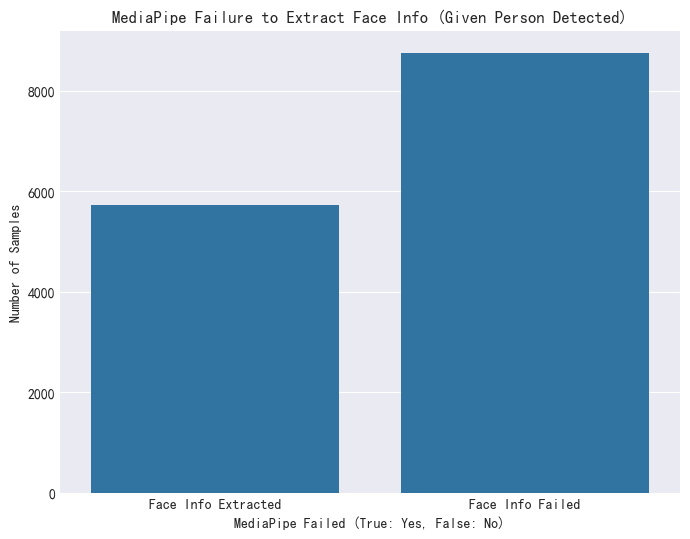

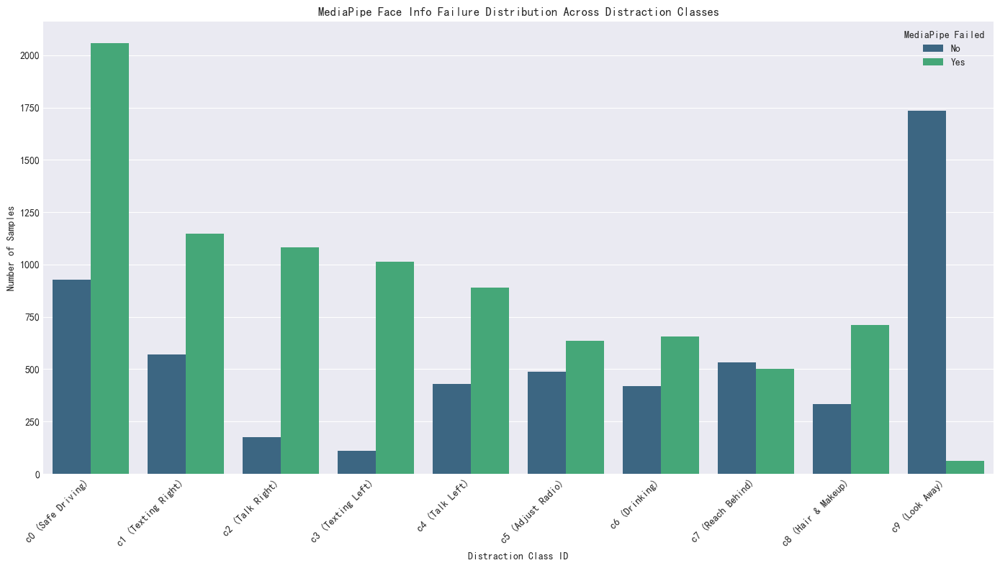

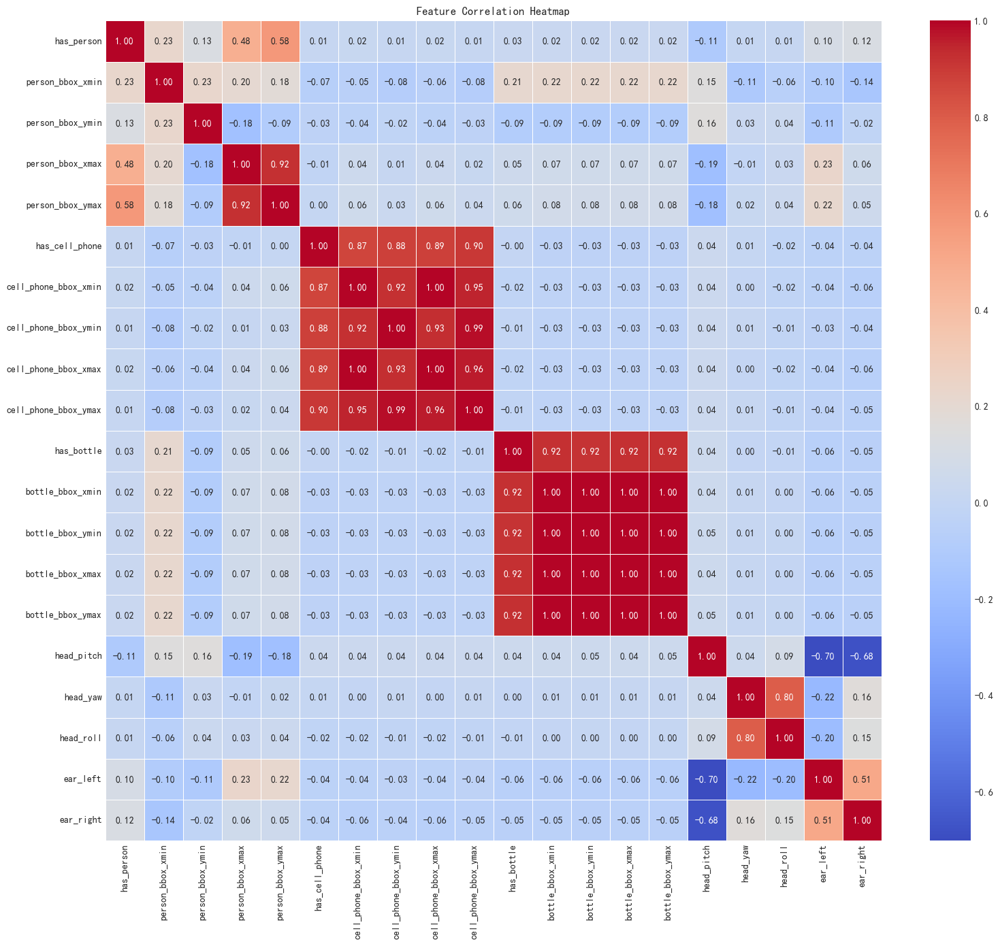

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np # Used for numerical operations, e.g., checking for default values

# --- Configuration Paths (Matches paths from your local Notebook code) ---
# Get the directory where the current Notebook file is located
# os.getcwd() returns the directory of the .ipynb file itself when run in Jupyter
# Assuming the Notebook is running in the '5831/' directory
BASE_DIR = os.getcwd() 

# Path to your extracted features CSV
# Assuming extracted_features.csv is directly under BASE_DIR/output/ (as it's downloaded from Kaggle)
FEATURES_CSV_PATH = os.path.join(BASE_DIR, 'extracted_features.csv')
# Path to your image labels CSV (May not be directly used if 'original_class' is in features_df)
LABELS_CSV_PATH = os.path.join(BASE_DIR, 'image_labels.csv') 

print(f"Loading features from: {FEATURES_CSV_PATH}")

# 1. Load Data
try:
    features_df = pd.read_csv(FEATURES_CSV_PATH)
    # Ensure 'original_class' is integer type for easier plotting
    features_df['original_class'] = features_df['original_class'].astype(int)
    print(f"Successfully loaded {len(features_df)} samples.")
except FileNotFoundError:
    print(f"Error: {FEATURES_CSV_PATH} not found. Please check the path and ensure the file exists.")
    exit() # Stop execution if file is not found

# --- 2. Data Overview ---
print("\n--- Feature DataFrame Head ---")
print(features_df.head())
print("\n--- Feature DataFrame Info ---")
features_df.info()
print("\n--- Feature DataFrame Describe ---")
print(features_df.describe())

# --- 3. Visualization Analysis ---

plt.style.use('seaborn-v0_8-darkgrid') # Use a modern seaborn style
plt.rcParams['font.sans-serif'] = ['SimHei'] # Optional: For displaying Chinese characters (e.g., if labels were Chinese)
plt.rcParams['axes.unicode_minus'] = False # Optional: For correct display of negative signs with Chinese fonts


# 3.1 Bar chart showing 'has_person' distribution (0 and 1 cases)
plt.figure(figsize=(8, 6))
sns.countplot(x='has_person', data=features_df)
plt.title('Distribution of "has_person" (YOLO Detected Person)')
plt.xlabel('Has Person (0: No, 1: Yes)')
plt.ylabel('Number of Samples')
plt.xticks([0, 1], ['No Person', 'Has Person'])
plt.show()

# 3.2 Distribution of 'original_class' (Bar chart for c0 to c9)
plt.figure(figsize=(12, 7))
sns.countplot(x='original_class', data=features_df, palette='viridis')
plt.title('Distribution of Original Distraction Classes (c0-c9)')
plt.xlabel('Distraction Class ID')
plt.ylabel('Number of Samples')
# Optional: Replace X-axis ticks with more descriptive names
ORIGINAL_CLASS_NAMES = {
    0: 'c0 (Safe Driving)',
    1: 'c1 (Texting Right)',
    2: 'c2 (Talk Right)',
    3: 'c3 (Texting Left)',
    4: 'c4 (Talk Left)',
    5: 'c5 (Adjust Radio)',
    6: 'c6 (Drinking)',
    7: 'c7 (Reach Behind)',
    8: 'c8 (Hair & Makeup)',
    9: 'c9 (Look Away)',
}
plt.xticks(
    list(ORIGINAL_CLASS_NAMES.keys()),
    list(ORIGINAL_CLASS_NAMES.values()),
    rotation=45, ha='right' # Rotate labels to prevent overlap
)
plt.tight_layout() # Adjust layout to prevent labels from overlapping
plt.show()

# 3.3 Proportion of samples where 'has_person' is 1 (Pie chart)
has_person_ratio = features_df['has_person'].value_counts(normalize=True) * 100
print(f"\n--- Proportion of samples with 'has_person' ---")
print(has_person_ratio)
plt.figure(figsize=(8, 8))
plt.pie(has_person_ratio, labels=['Has Person', 'No Person'], autopct='%1.1f%%', startangle=90, colors=['lightskyblue', 'lightcoral'])
plt.title('Proportion of Samples with Person Detected')
plt.show()


# 3.4 Case where 'has_person' is 1 but MediaPipe failed to extract face orientation/EAR info
# This typically manifests as head_pitch, head_yaw, head_roll, ear_left, ear_right all being default values (0.0)
# We need to check if these columns are all 0.0
# Create a helper column to indicate if MediaPipe successfully extracted pose/EAR
features_df['mediapipe_failed_face_info'] = (
    (features_df['has_person'] == 1) & 
    (features_df['head_pitch'] == 0.0) & 
    (features_df['head_yaw'] == 0.0) & 
    (features_df['head_roll'] == 0.0) & 
    (features_df['ear_left'] == 0.0) & 
    (features_df['ear_right'] == 0.0)
)
# Count the distribution of this situation
mediapipe_failure_distribution = features_df['mediapipe_failed_face_info'].value_counts(normalize=True) * 100

print(f"\n--- Proportion of samples where MediaPipe failed to extract face info (despite has_person=1) ---")
print(mediapipe_failure_distribution)

plt.figure(figsize=(8, 6))
sns.countplot(x='mediapipe_failed_face_info', data=features_df)
plt.title('MediaPipe Failure to Extract Face Info (Given Person Detected)')
plt.xlabel('MediaPipe Failed (True: Yes, False: No)')
plt.ylabel('Number of Samples')
plt.xticks([0, 1], ['Face Info Extracted', 'Face Info Failed'])
plt.show()

# 3.5 Cross-analysis: Distribution of MediaPipe failures across different original_class (Bar chart)
# Check which distraction classes are more prone to MediaPipe failing to detect face pose/EAR
plt.figure(figsize=(14, 8))
sns.countplot(x='original_class', hue='mediapipe_failed_face_info', data=features_df, palette='viridis')
plt.title('MediaPipe Face Info Failure Distribution Across Distraction Classes')
plt.xlabel('Distraction Class ID')
plt.ylabel('Number of Samples')
plt.xticks(
    list(ORIGINAL_CLASS_NAMES.keys()),
    list(ORIGINAL_CLASS_NAMES.values()),
    rotation=45, ha='right'
)
plt.legend(title='MediaPipe Failed', labels=['No', 'Yes'])
plt.tight_layout()
plt.show()


# 3.6 Heatmap: Feature Correlation (Optional, if feature count is not too high)
# Drop columns not needed for correlation, like original_class and mediapipe_failed_face_info
# Binary features like has_person, has_cell_phone, has_bottle can be included or excluded selectively
correlation_matrix = features_df.drop(columns=['original_class', 'mediapipe_failed_face_info']).corr()
plt.figure(figsize=(16, 14))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Feature Correlation Heatmap')
plt.tight_layout()
plt.show()


# 3.7 Other useful visualization suggestions (you can add as needed)
# - Bar chart or pie chart for 'has_cell_phone' and 'has_bottle' distribution.
# - Histograms/KDE plots for head pose (head_pitch, head_yaw, head_roll), especially on the subset where 'has_person' is 1.
# - Histograms/KDE plots for EAR (ear_left, ear_right), on the subset where 'has_person' is 1.
# - Box plots for a specific head pose angle (e.g., Yaw) across different original_class, to visually identify distinct head turns.